## Original Split 3

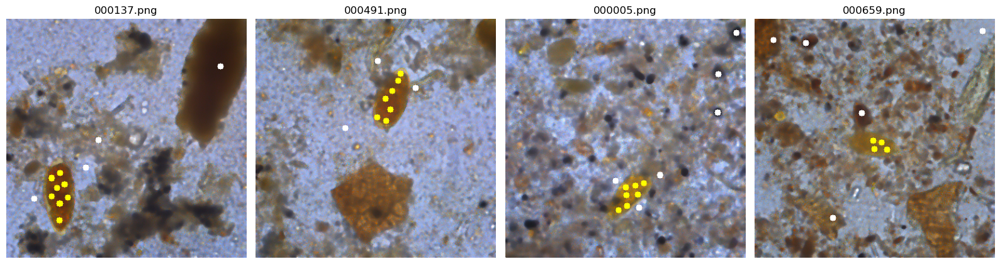

In [1]:
import os
import matplotlib.pyplot as plt
import cv2

split = 3
markers_path = f"../data/schisto/split{split}/markers/"

def display_flim_dataset(marker_path):
    images_path = "../datasets/schisto/images/"
    markers_files = os.listdir(markers_path)

    fig, axs = plt.subplots(1, len(markers_files), figsize=(16, 8))
    axs = axs.flatten()

    for i, file in enumerate(markers_files):

        img_name = file.replace("-seeds.txt", ".png")  # FIXED
        img_path = os.path.join(images_path, img_name)
        marker_path = os.path.join(markers_path, file)

        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # FIXED

        seeds_img = img.copy()

        with open(marker_path, "r") as txt_file:
            next(txt_file)  # skip header
            for line in txt_file:
                seed = [int(j) for j in line.strip().split()]  # FIXED
                # seed = [int(j) for j in line.strip().split(" ")]
                x, y, _, cls, __ = seed

                if cls == 0:
                    seeds_img[y, x] = [255, 255, 255]
                elif cls == 1:
                    seeds_img[y, x] = [255, 255, 0]

        axs[i].imshow(seeds_img)
        axs[i].axis('off')
        axs[i].set_title(img_name)

    plt.tight_layout()
    plt.show()
    return

display_flim_dataset(markers_path)

## Split 3 v2

# Testing FLIM model

In [2]:
import os
import time
import torch
import numpy as np
import pandas as pd
import torch.nn as nn
from pyflim import data
import pyift.pyift as ift
from pyflim import layers
from skimage import measure
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
# from torchvision import tv_tensors
import torchvision.transforms.v2 as T
from torch.utils.data import DataLoader
from scipy.spatial.distance import cdist
from skimage.filters import threshold_otsu
from PIL import Image, ImageOps, ImageDraw, ImageFilter
from skimage.morphology import binary_dilation, binary_erosion, disk

torch.manual_seed(123)
rng = np.random.default_rng(2021)

## Config

In [3]:
split = 3
home = "/home/user/mo445/mo445-tarefa-2-flim"
orig_folder = f"{home}/datasets/schisto/images/"
label_folder= f"{home}/datasets/schisto/truelabels/"
marker_folder = f"{home}/data/schisto/split{split}/markers/"
train_split_file = f"{home}/data/schisto/split{split}/train{split}.csv"
test_split_file = f"{home}/data/schisto/split{split}/test{split}.csv"

# lr=1e-3
# wd=1e-4
device = 'cuda:0'
# epochs = 100
# lr_gamma = 0.97

## Dataloaders


In [4]:
images_list_flim_training = [i.replace("-seeds.txt", "") for i in os.listdir(marker_folder)] # list image filenames for flim training

images_list_gwe_training_ = list(pd.read_csv(train_split_file, header=None)[0]) # list image filenames for gwe (graph weight estimator) training
images_list_gwe_training_ = [i.replace('images/', '').replace('.png', '') for i in images_list_gwe_training_ 
                            if i not in images_list_flim_training and np.array(Image.open(label_folder+i.replace('images/', ''))).max() > 0] # remove blank labels and images in flim training

# this can be used to train the graph weight estimator with more images from trainN.csv
p = 0.5 # separating training and validation sets
len_ = len(images_list_gwe_training_)
images_list_gwe_training = images_list_gwe_training_[:int(p*len_)]
images_list_gwe_val = images_list_gwe_training_[int(p*len_):]

images_list_gwe_test_ = list(pd.read_csv(test_split_file, header=None)[0])
images_list_gwe_test = [i.replace('images/', '').replace('.png', '') for i in images_list_gwe_test_]

print('Nº Images for FLIM training:', len(images_list_flim_training))
print('Nº Images for GWE training:', len(images_list_gwe_training))
print('Nº Images for GWE validation:', len(images_list_gwe_val))
print('Nº Images for GWE test:', len(images_list_gwe_test))

train_dataset_flim_ = data.FLIMData(orig_folder=orig_folder, marker_folder=marker_folder, 
                                images_list=images_list_flim_training, label_folder=label_folder,
                                orig_ext=".png", marker_ext="-seeds.txt", label_ext=".png",
                                transform=None,lab_norm=False)

train_dataset_gwe_ = data.FLIMData(orig_folder=orig_folder, images_list=images_list_gwe_training, 
                                  label_folder=label_folder, orig_ext=".png",label_ext=".png",
                                transform=None,lab_norm=False)

val_dataset_gwe = data.FLIMData(orig_folder=orig_folder, images_list=images_list_gwe_val, 
                                  label_folder=label_folder, orig_ext=".png",label_ext=".png",
                                transform=None,lab_norm=False)

test_dataset_gwe_ = data.FLIMData(orig_folder=orig_folder, images_list=images_list_gwe_test, 
                                  label_folder=label_folder, orig_ext=".png",label_ext=".png",
                                transform=None,lab_norm=False)

train_dataset_gwe = DataLoader(train_dataset_gwe_, batch_size=1, shuffle=True) #train dataset for more than 3-4 images(not used yet)
train_dataset_flim = DataLoader(train_dataset_flim_, batch_size=1, shuffle=True) #train dataset with 3-4 images
test_dataset_gwe = DataLoader(test_dataset_gwe_, batch_size=1, shuffle=True) #test dataset

Nº Images for FLIM training: 4
Nº Images for GWE training: 163
Nº Images for GWE validation: 163
Nº Images for GWE test: 610


## Utils


In [5]:
#Filter components by area
def filter_component_by_area(saliency, area_range=[1800,10000]):
    bin_sal = np.copy(saliency)
    thresh = threshold_otsu(saliency)
    bin_sal[saliency>thresh] = 1
    bin_sal[saliency<=thresh] = 0
    saliency[bin_sal == 0] = 0
    sal_components_image = measure.label(bin_sal, background=0, connectivity=2)
    sal_nb_components = sal_components_image.max()
    
    bbs = []
    for c_ in range(1,sal_nb_components+1):
        area = len(sal_components_image[sal_components_image == c_])
        
        if (area < area_range[0] or area > area_range[1]):
            saliency[sal_components_image == c_] = 0
                
    return saliency
#select random pixels on binary images
def random_select(mask, percentage=0.3):
    mask = mask.astype(bool)
    
    indices = np.flatnonzero(mask)
    
    num_select = int(len(indices) * percentage)
    selected = rng.choice(indices, num_select, replace=False)
    
    new_mask = np.zeros_like(mask, dtype=np.uint8)
    new_mask.flat[selected] = 1
    return new_mask

def dice_score(true, pred):
        true = np.copy(true)
        pred = np.copy(pred)
        true[true > 0] = 1
        pred[pred > 0] = 1
        inter = true * pred
        denom = true + pred
        if(true.sum() == 0 and pred.sum() > 0):
            return 0.0
        elif(true.sum() > 0 and pred.sum() == 0):
            return 0.0
        elif(true.sum() == 0 and pred.sum() == 0):
            return 1.0
        return 2.0 * np.sum(inter) / np.sum(denom)

def f_beta_score(pred, gt, beta2=0.3, threshold=0.5):
    # Binarize prediction
    pred_bin = (pred >= threshold).astype(np.uint8)

    if(pred.max()==0 and gt.max()==0):
        return 1.0

    TP = np.sum((pred_bin == 1) & (gt == 1))
    FP = np.sum((pred_bin == 1) & (gt == 0))
    FN = np.sum((pred_bin == 0) & (gt == 1))

    if TP == 0:
        return 0.0
    
    precision = TP / (TP + FP + 1e-8)
    recall    = TP / (TP + FN + 1e-8)

    f_beta = ((1 + beta2) * precision * recall) / (beta2 * precision + recall + 1e-8)
    return float(f_beta)

def labnorm(image):
    new_image = torch.empty_like(image, dtype=image.dtype)

    new_image[:,0, :, :] = image[:,0, :, :] / 99.998337
    new_image[:,1, :, :] = (image[:,1, :, :] + 86.182236) / (86.182236 + 98.258614)
    new_image[:,2, :, :] = (image[:,2, :, :] + 107.867744) / (107.867744 + 94.481682)

    return new_image

def draw_borders(img, mask, edge_width=1, color='magenta'):
    if mask.max() == 1:
        mask = mask * 255
    mask = Image.fromarray(mask).convert("L")

    edges = mask.filter(ImageFilter.FIND_EDGES)

    if edge_width > 1:
        size = 2 * edge_width + 1
        edges = edges.filter(ImageFilter.MaxFilter(size=size))

    edges_rgb = ImageOps.colorize(edges.convert('L'), black='black', white=color)

    img = img.copy()
    img.paste(edges_rgb, mask=edges)

    return img


## Test Functions


In [35]:

def test_step(sample, model):
    x,y,p=sample['image'].cuda(),sample['label'], sample['image_path']
    y[y>0] = 1
    
    y = y[0].cpu().numpy()

    y[y>0] = 1
    # y = y[0].cpu().numpy()


    x_t = labnorm(x)
    # y_t = model.forward(x_t, decoder_layer=1)
    y_t = model.forward(x_t)
    y_t = y_t.squeeze().detach().cpu().numpy().astype(np.int32)
    
    y_t_p = y_t.copy()
    th = threshold_otsu(y_t_p)
    y_t_p[y_t_p<th] = 0
    y_t_p[y_t_p>0] = 1
    y_t_p = filter_component_by_area(y_t_p.astype(np.uint8), area_range=[1000,9000])


    triplet = {}
    # print("IMAGE_PATH: ", sample["image_path"])
    triplet["name"] = sample['image_path'][0]
    triplet["original"] = sample['image'][0].permute(1, 2, 0).cpu().numpy()
    # triplet["gt"] = y_np
    triplet['representation'] = y_t
    
    # filtering best connected component
    y_t = y_t.astype(np.int32)
    y_t_p = y_t.copy()
    th = threshold_otsu(y_t_p)
    y_t_p[y_t_p<th] = 0
    y_t_p[y_t_p>0] = 1
    y_t_p_filtered = filter_component_by_area(y_t_p.astype(np.uint8), area_range=[1000,9000])
    triplet['otsu'] = y_t_p
    triplet['filtered_representation'] = y_t_p_filtered

    display_triplet(triplet, ["Original", "FLIM output", "Otsu"])
    return

def test_flim(dataset, model):
    for i, sample in enumerate(dataset):
        test_step(sample, model)
    return

def display_triplet(t, titles):
    """
    triplets: list of dicts with keys:
        {
            "name": str,
            "original": np array,
            "gt": np array,
            "representation": np array
        }
    """

    name = t["name"][-10:]
    # orig = t["original"][..., ::-1]
    orig = np.array(Image.open(t["name"]))

    # gt = t["gt"]
    rep = t["representation"]
    # filtered = t['filtered_representation']
    otsu = t['otsu']

    # --- Create a 1×3 panel figure ---
    fig, axes = plt.subplots(1, len(titles), figsize=(12, 4))
    
    images = [orig, rep, otsu]

    for ax, img, title in zip(axes, images, titles):
        ax.imshow(img, cmap="gray" if img.ndim == 2 else None)
        ax.set_title(title)
        ax.axis("off")

    plt.suptitle(name, fontsize=14)

    plt.tight_layout()
    plt.show()

    return

def display_flim_outputs(t, titles):
    """
    triplets: list of dicts with keys:
        {
            "name": str,
            "original": np array,
            "gt": np array,
            "representation": np array
        }
    """

    name = t["name"][-10:]
    # orig = t["original"][..., ::-1]
    orig = np.array(Image.open(t["name"]))

    # # gt = t["gt"]
    # rep = t["representation"]
    # # filtered = t['filtered_representation']
    # otsu = t['otsu']

    # --- Create a 1×3 panel figure ---
    fig, axes = plt.subplots(1, len(titles), figsize=(12, 4))
    
    # images = [orig, rep, otsu]
    remaining_keys = list(t.keys())[1:]  # skip 'name'
    images = [orig] + [t[k] for k in remaining_keys]  # append in order

    for ax, img, title in zip(axes, images, titles):
        ax.imshow(img, cmap="gray" if img.ndim == 2 else None)
        ax.set_title(title)
        ax.axis("off")

    plt.suptitle(name, fontsize=14)

    plt.tight_layout()
    plt.show()

    return

def compare_flims(dataset, flim1, flim2):
    for i, sample in enumerate(dataset):
        print(f"Modelo 1")
        test_step(sample, flim1)
        print(f"Modelo 2")
        test_step(sample, flim2)
    return

def mix_flims(dataset, flim1, flim2):
    for i, sample in enumerate(dataset):

        x,y,p=sample['image'].cuda(),sample['label'], sample['image_path']

        y[y>0] = 1
        
        # y = y[0].cpu().numpy()
        y_np = y[0].cpu().numpy()
        x_t = labnorm(x)

        ### FLIM 1
        # y_t = model.forward(x_t, decoder_layer=1)
        y_t = flim1.forward(x_t)
        y_t = y_t.squeeze().detach().cpu().numpy().astype(np.int32)
        
        y_t_p = y_t.copy()
        th = threshold_otsu(y_t_p)
        y_t_p[y_t_p<th] = 0
        y_t_p[y_t_p>0] = 1
        # y_t_p = filter_component_by_area(y_t_p.astype(np.uint8), area_range=[1000,9000])

        y_t_p1 = y_t_p.copy()

        ### FLIM 2
        # y_t = model.forward(x_t, decoder_layer=1)
        y_t = flim2.forward(x_t)
        y_t = y_t.squeeze().detach().cpu().numpy().astype(np.int32)
        
        y_t_p = y_t.copy()
        th = threshold_otsu(y_t_p)
        y_t_p[y_t_p<th] = 0
        y_t_p[y_t_p>0] = 1
        # y_t_p = filter_component_by_area(y_t_p.astype(np.uint8), area_range=[1000,9000])

        y_t_p2 = y_t_p.copy()


        y_t_p = cv2.bitwise_and(y_t_p1, y_t_p2)


        triplet = {}
        # print("IMAGE_PATH: ", sample["image_path"])
        triplet["name"] = sample['image_path'][0]
        triplet["gt"] = y_np
        triplet['flim1'] = y_t_p1
        triplet['flim2'] = y_t_p2
        triplet['and'] = y_t_p

        display_flim_outputs(triplet, ["Original", "GT", "FLIM1 Otsu", "FLIM2 Otsu", "FLIM1 AND FLIM2"])

    return

## Test...

In [26]:
flim_model1 = torch.load(f'../models/flim/split{split}/flim_encoder_split{split}.pth', weights_only=False).eval().to(device)
# flim_model1.decoder = layers.FLIMAdaptiveDecoderLayer(1,filter_by_size=False, device=device,adj_radius=1.5, decoder_type='mean_based_ad')

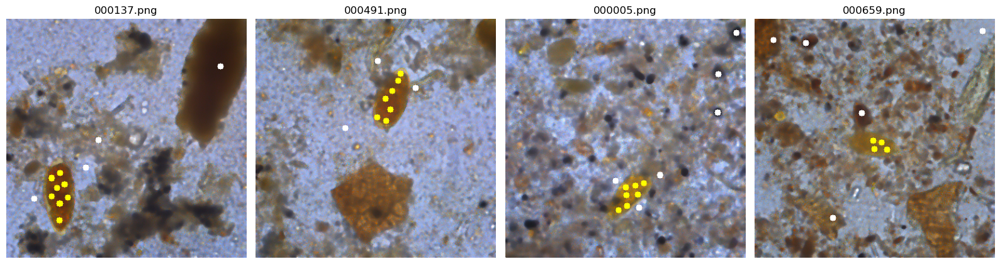

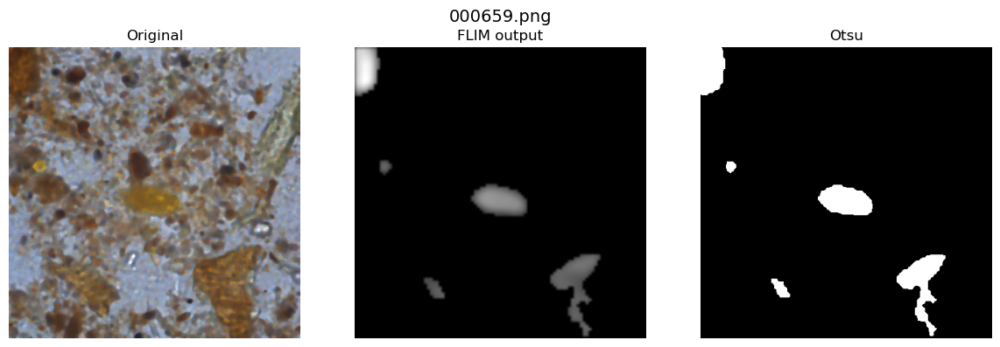

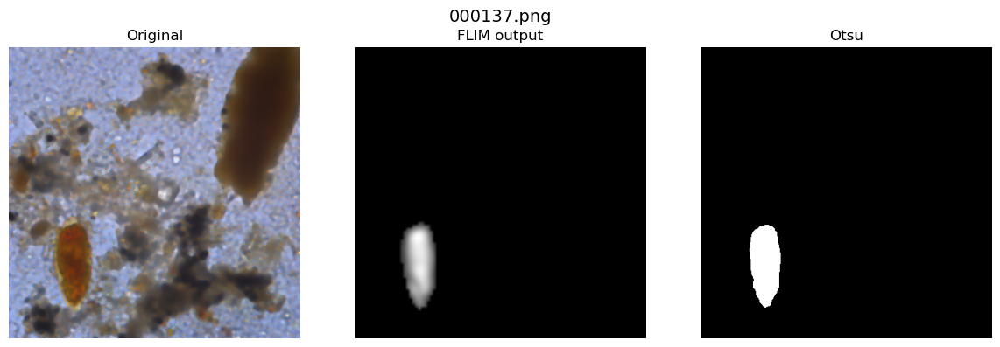

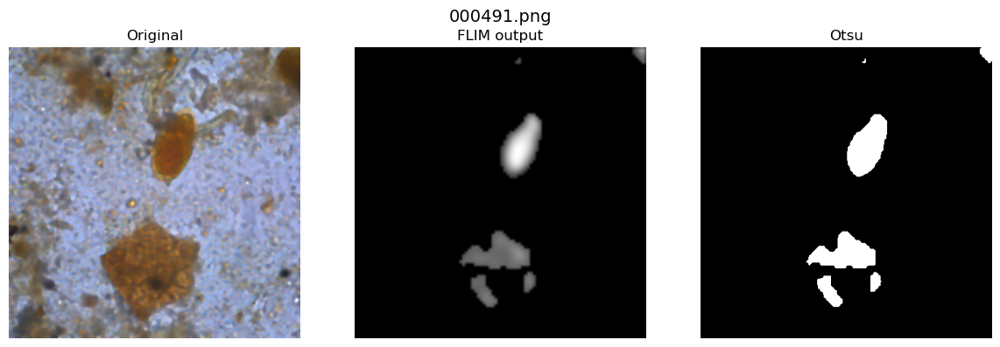

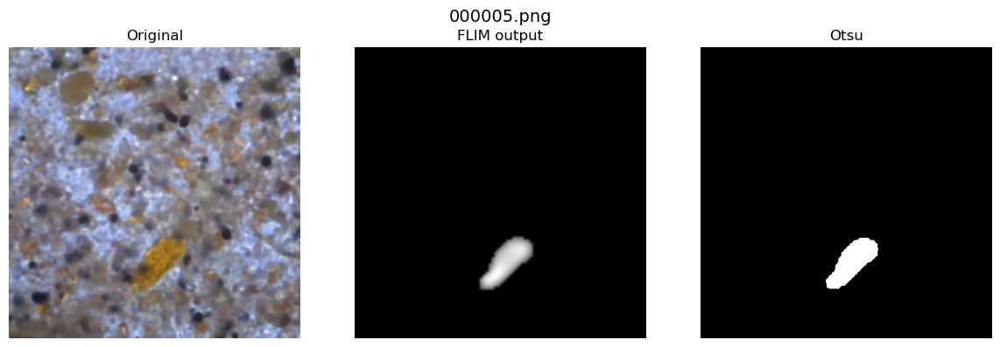

In [27]:
display_flim_dataset(markers_path)
test_flim(train_dataset_flim, flim_model1)

## FLIM - 8 layers / split3

In [12]:
flim_model2 = torch.load(f'../models/flim/mysplit{split}/flim_encoder_mysplit{split}.pth', weights_only=False).eval().to(device)
# flim_model2.decoder = layers.FLIMAdaptiveDecoderLayer(1,filter_by_size=False, device=device,adj_radius=1.5, decoder_type='mean_based_ad')

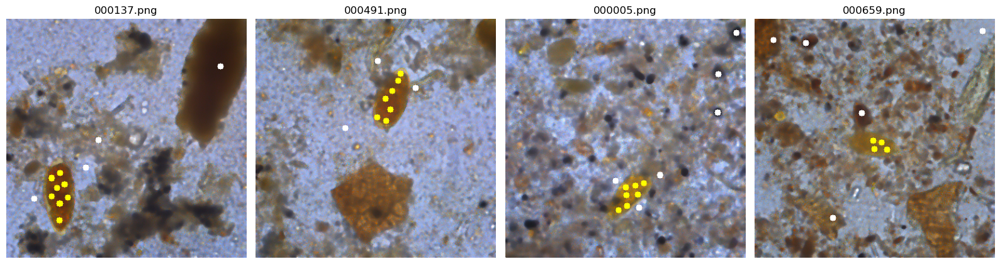

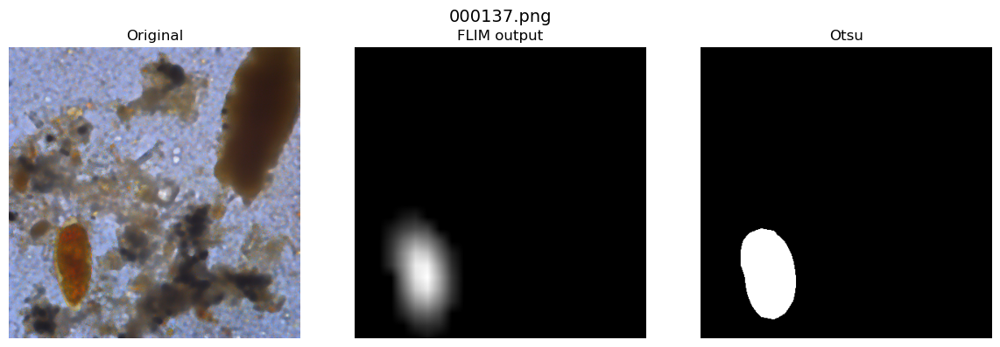

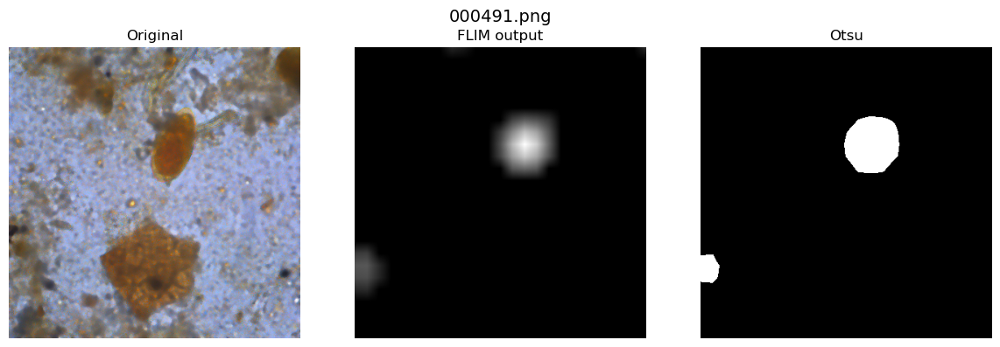

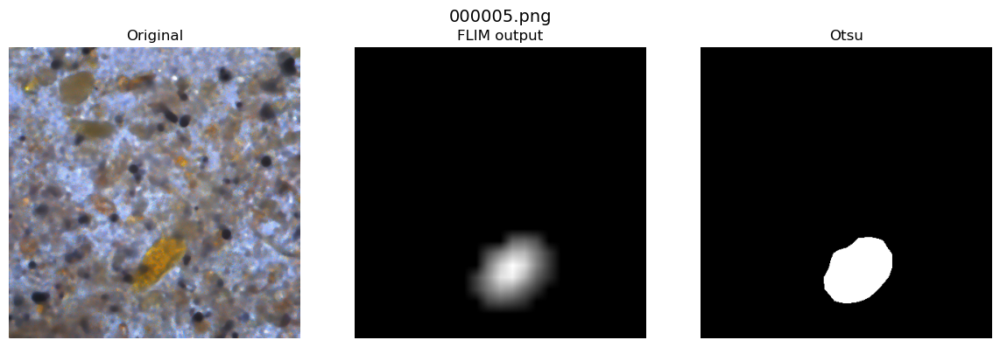

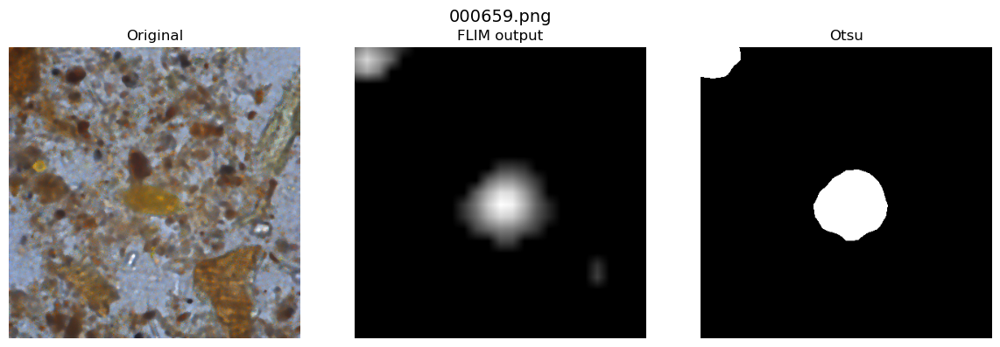

In [22]:
display_flim_dataset(markers_path)
test_flim(train_dataset_flim, flim_model2)

Modelo 1


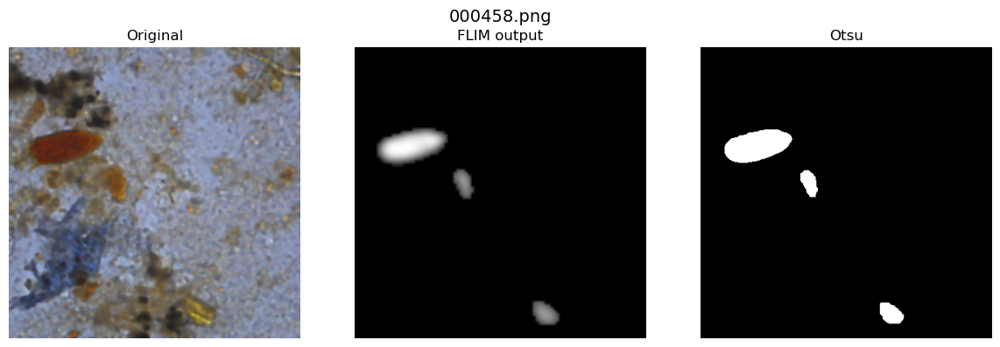

Modelo 2


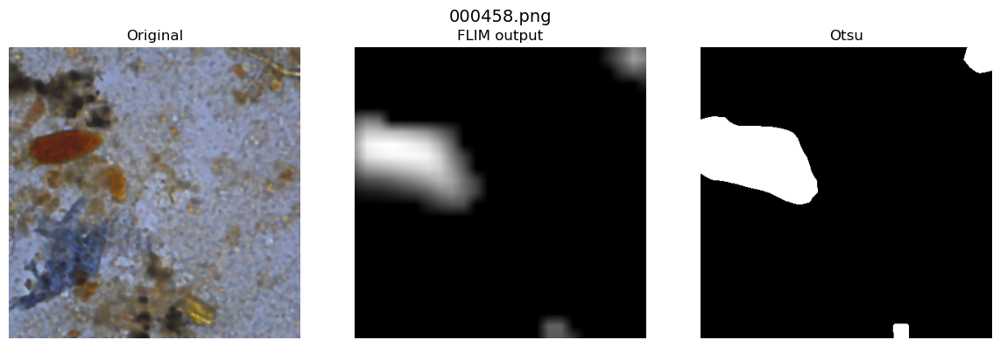

Modelo 1


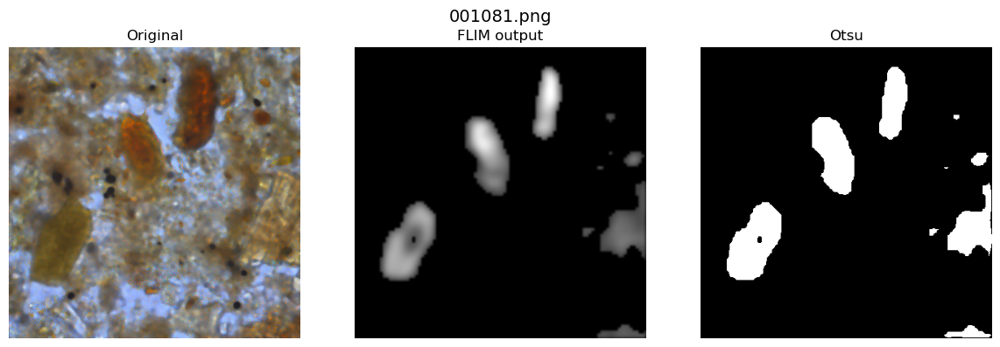

Modelo 2


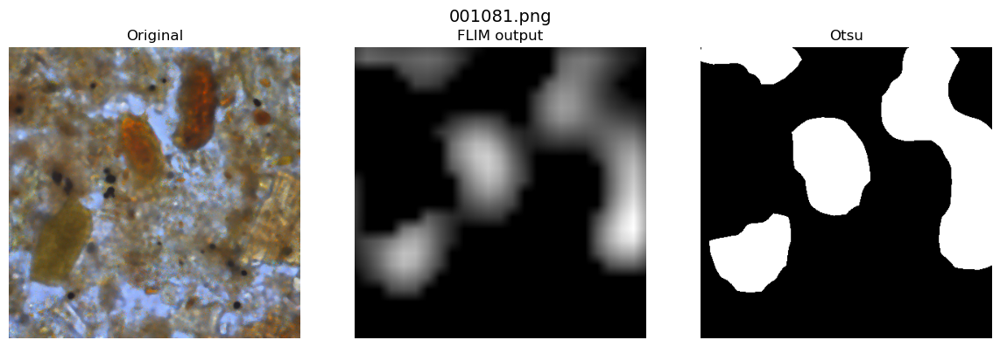

Modelo 1


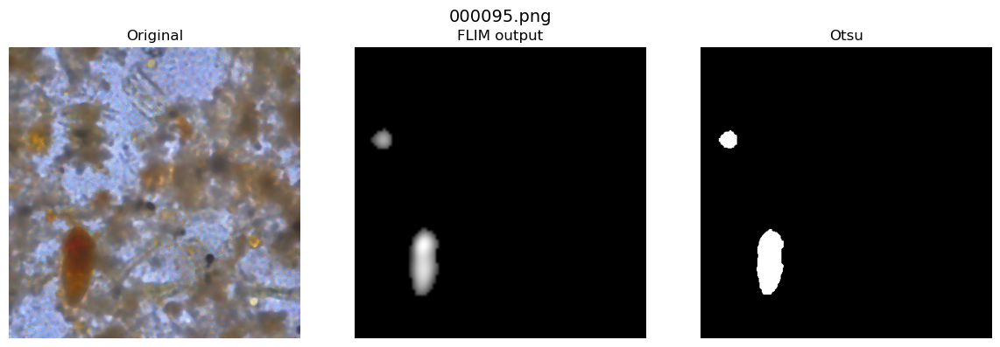

Modelo 2


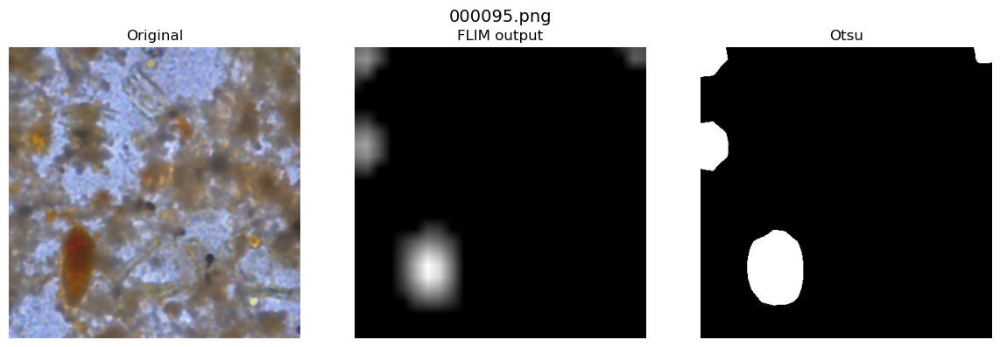

Modelo 1


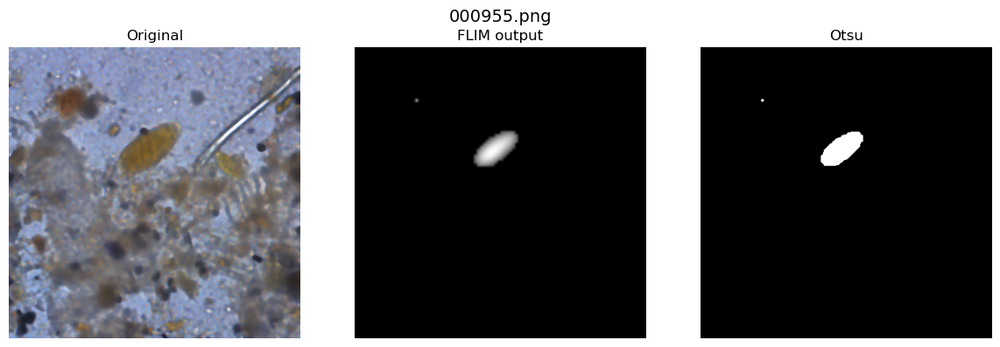

Modelo 2


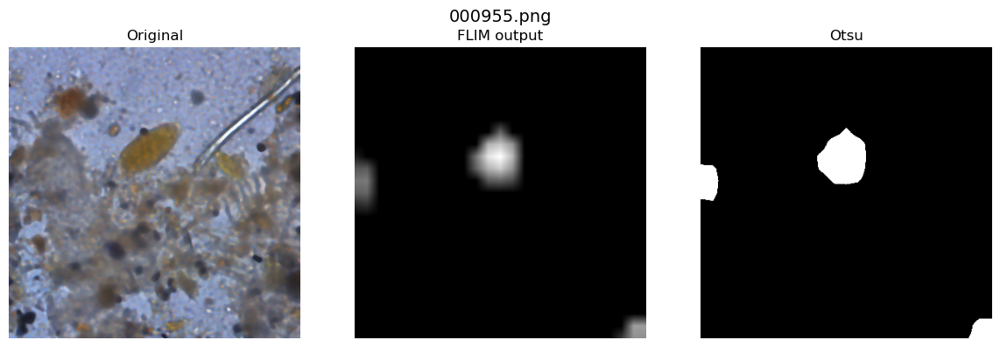

Modelo 1


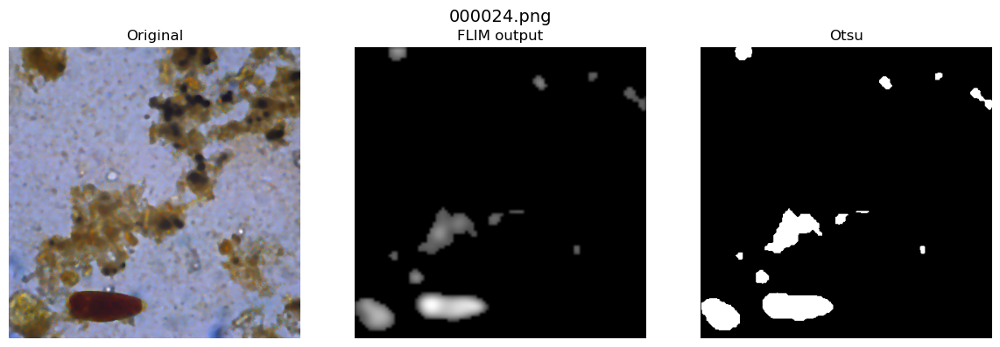

Modelo 2


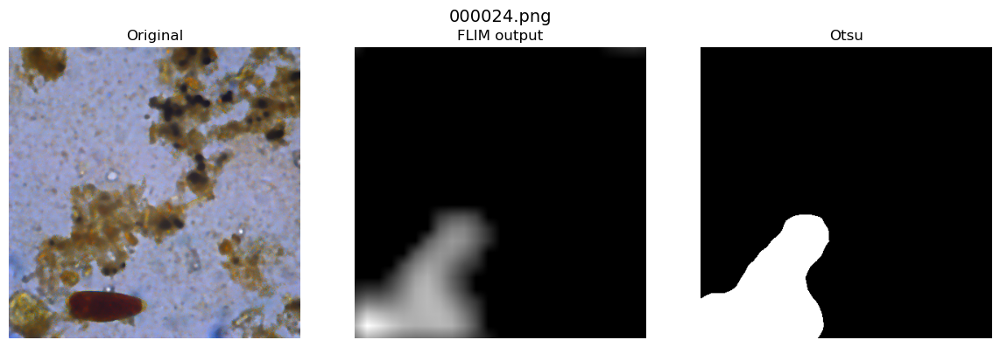

Modelo 1


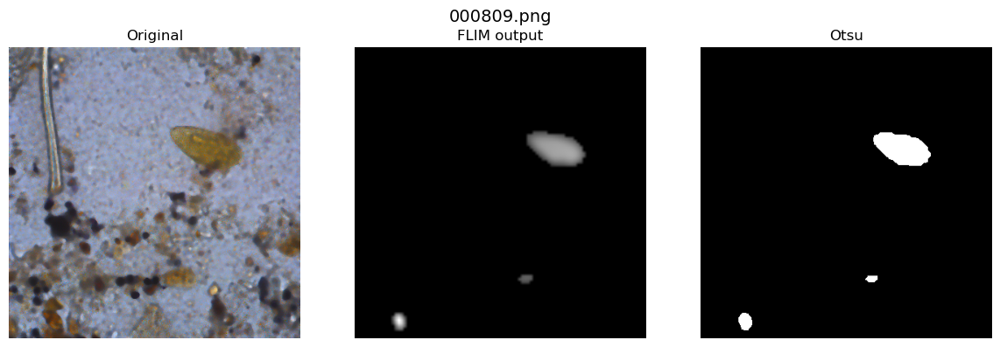

Modelo 2


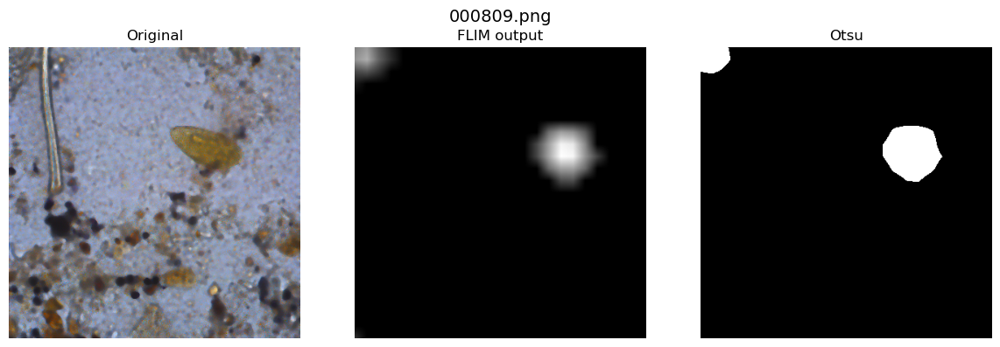

Modelo 1


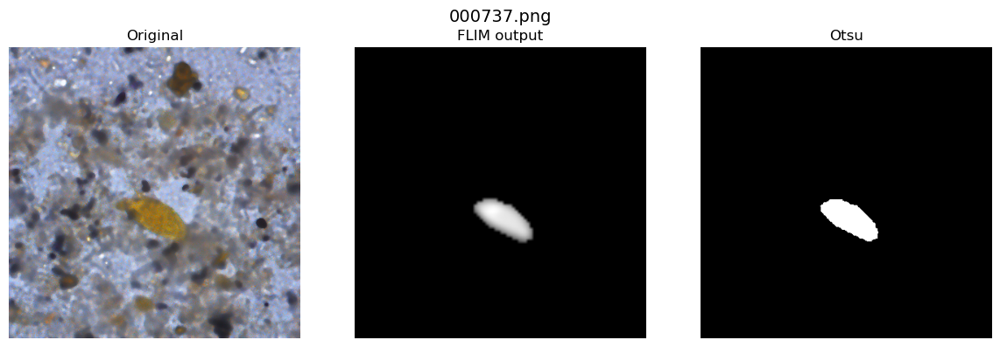

Modelo 2


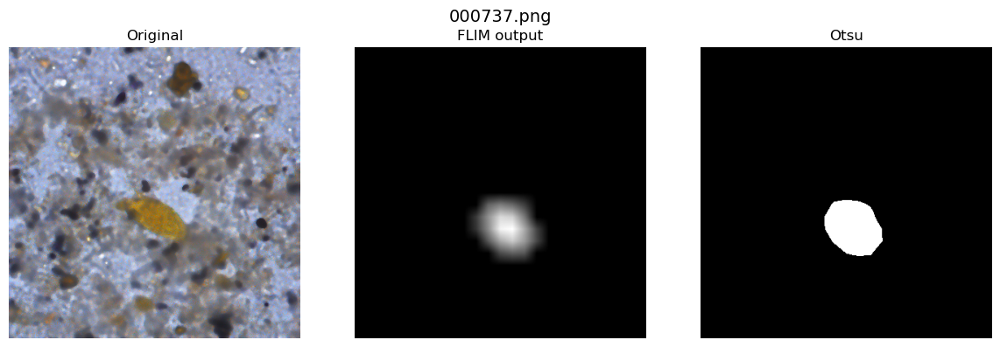

Modelo 1


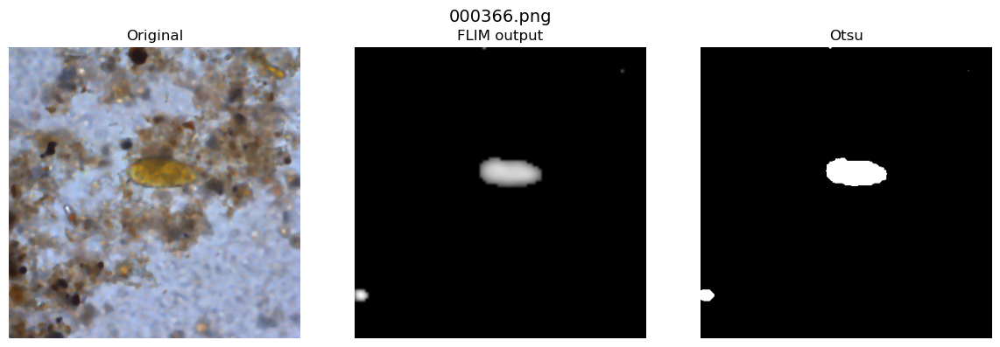

Modelo 2


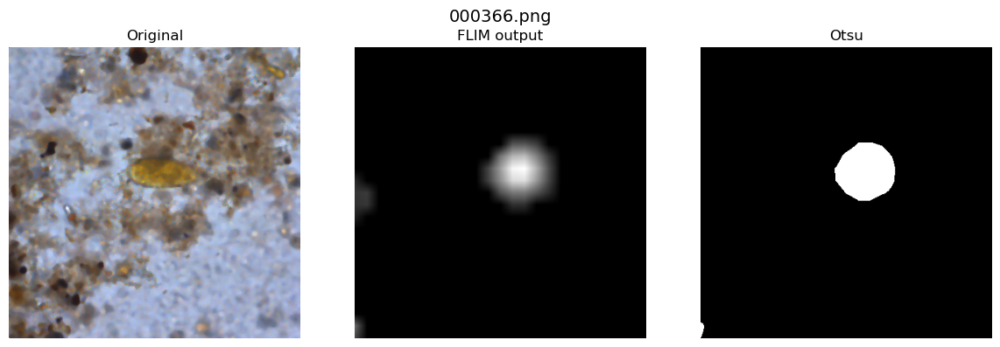

Modelo 1


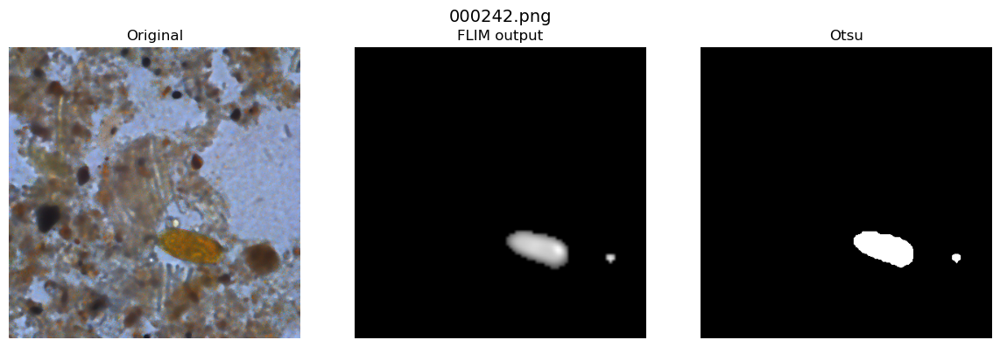

Modelo 2


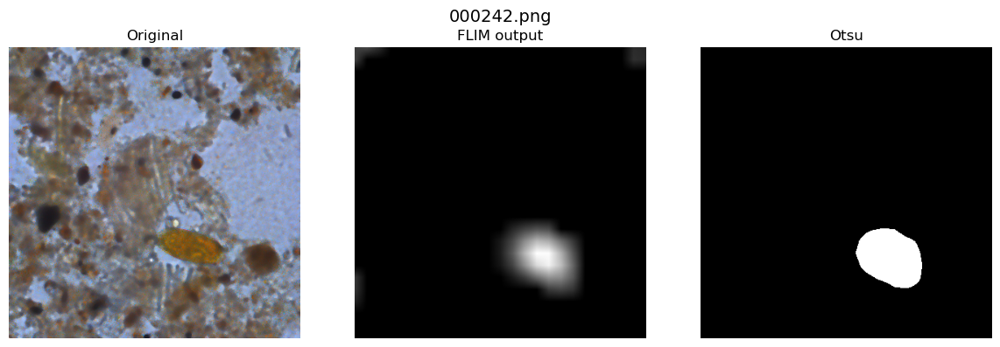

Modelo 1


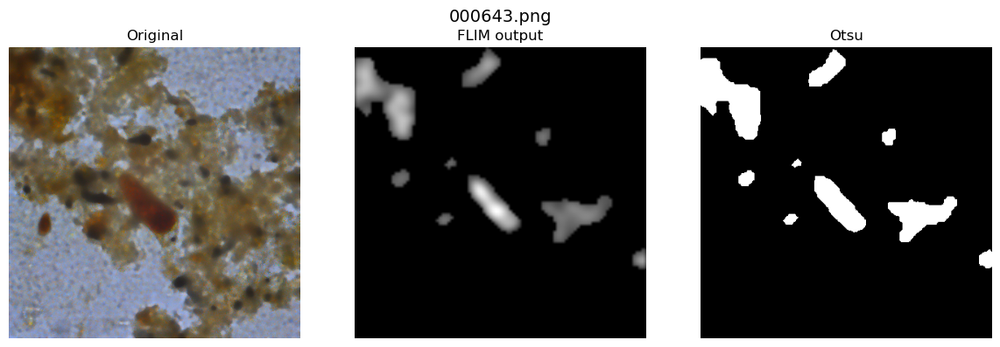

Modelo 2


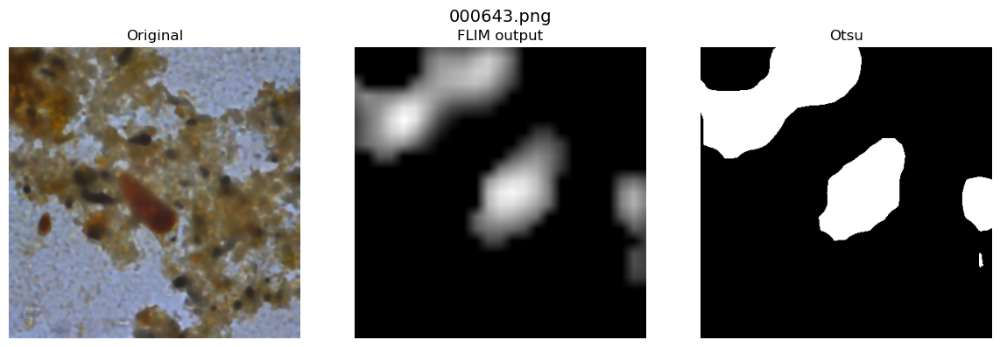

Modelo 1


KeyboardInterrupt: 

In [23]:
compare_flims(train_dataset_gwe, flim_model1, flim_model2)

In [18]:
dataset = train_dataset_flim

for i, sample in enumerate(dataset):
    x,y,p=sample['image'].cuda(),sample['label'], sample['image_path']
    y[y>0] = 1
    
    y = y[0].cpu().numpy()

    y[y>0] = 1
    # y = y[0].cpu().numpy()


    # x_t = labnorm(x)
    # y_t = model.forward(x_t, decoder_layer=1)
    # y_t = y_t.squeeze().detach().cpu().numpy().astype(np.int32)
        
    with torch.no_grad():
        x_t = labnorm(x)
        enc_out1 = flim_model1.forward(x_t, decoder_layer=1)
        enc_out2 = flim_model2.forward(x_t, decoder_layer=1)
        print(torch.allclose(enc_out1, enc_out2))  # Should be False

True
True
True
True


## Mix FLIMs

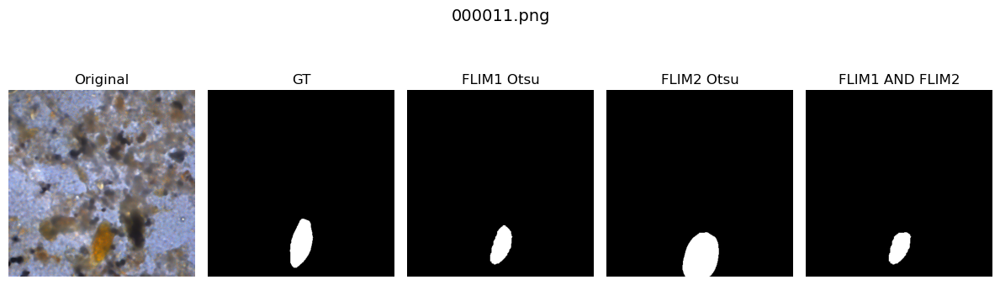

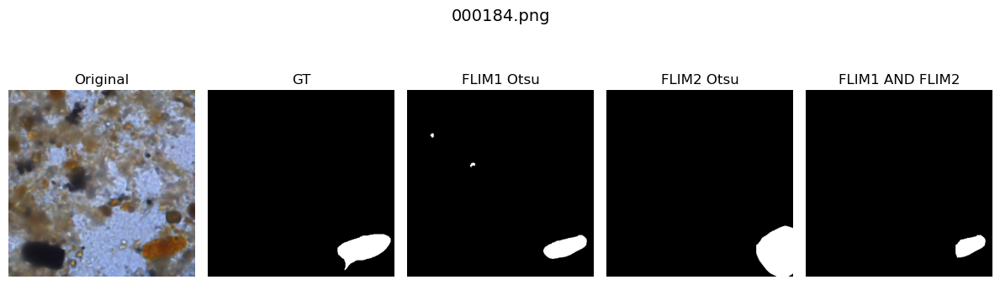

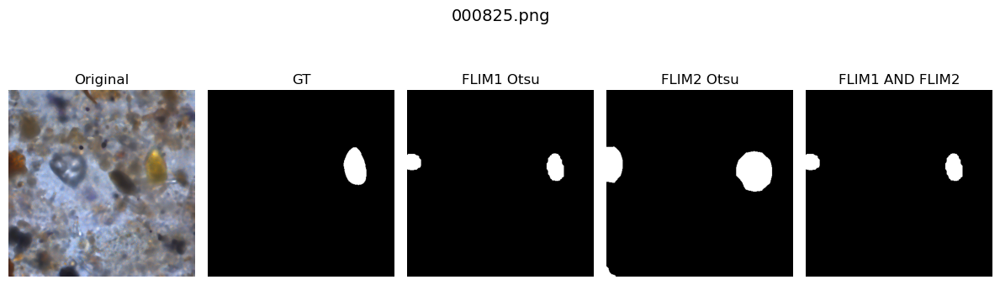

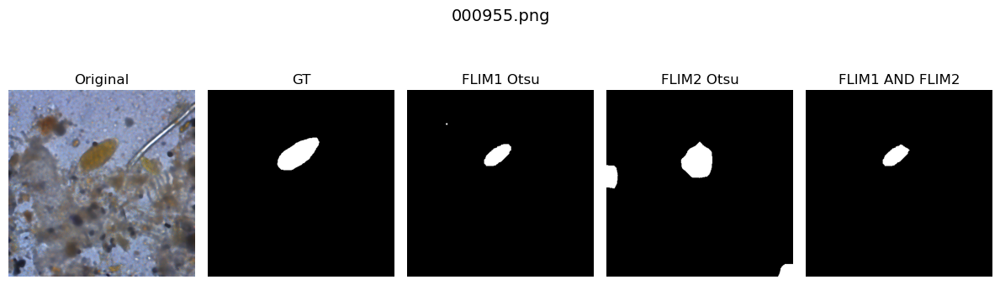

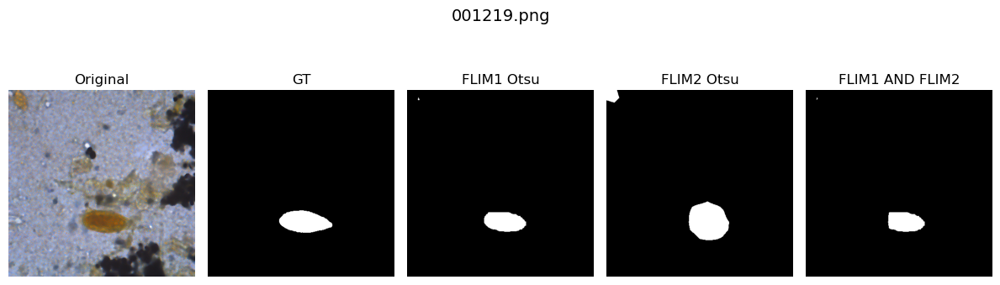

...

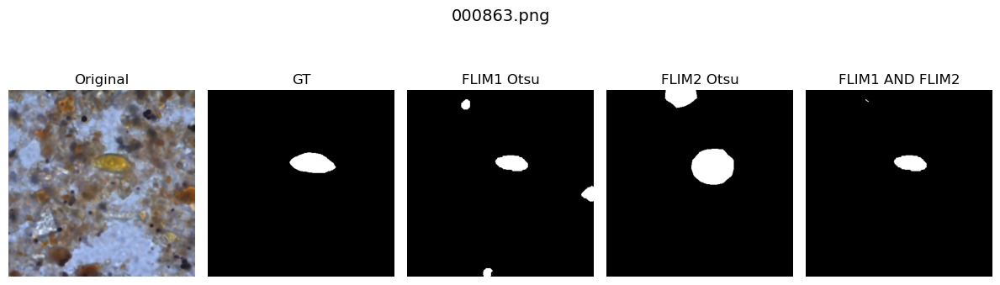

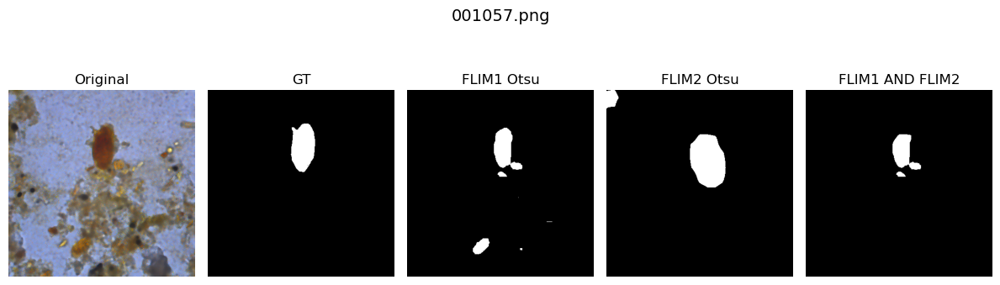

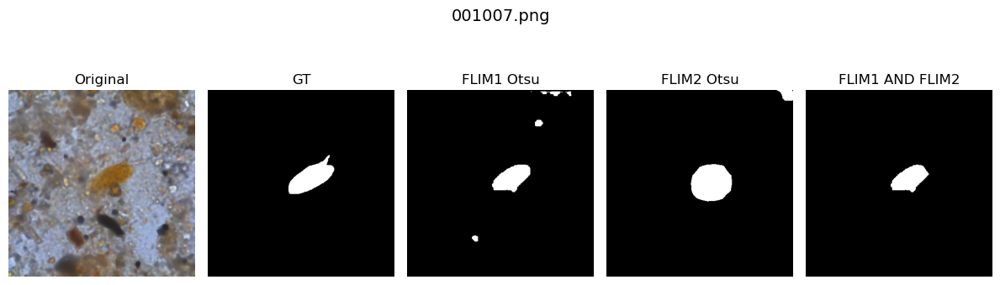

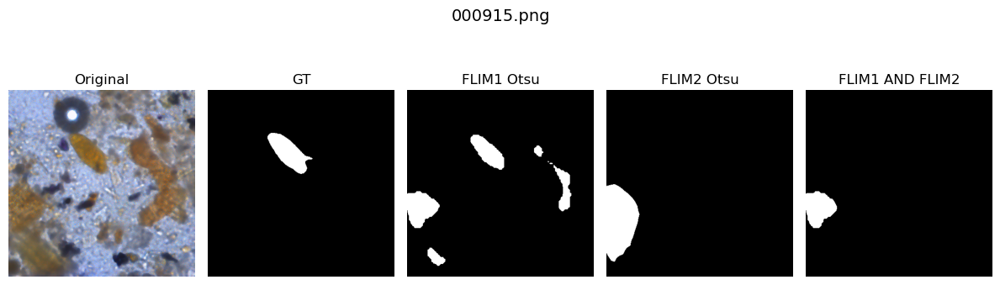

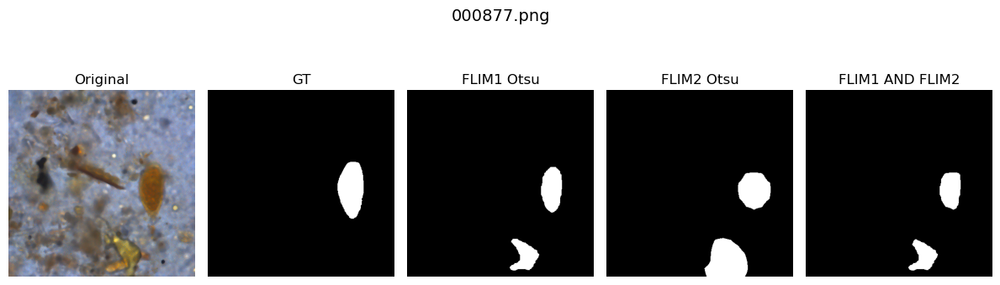

In [36]:
mix_flims(train_dataset_gwe, flim_model1, flim_model2)